<a href="https://colab.research.google.com/github/HowardHNguyen/Machine-Learning-Deep-Learning/blob/main/California_Influenza_like_Illness_Forecasting_by_NeuralProphet_By_All_Regions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Author by: Howard Nguyen

# Description:

The California Department of Public Health (CDPH) Influenza Surveillance Program (CISP) is a collaborative effort between CDPH, the Centers for Disease Control and Prevention (CDC), Kaiser Permanente, California local health jurisdictions and the participating California sentinel providers and sentinel laboratories. Influenza surveillance in California is particularly important due to its coastal location with several ports of entry for flights and shipping from Asia. Annual influenza epidemics follow a winter seasonal pattern in the United States with typical activity peaking during late December to early February. CDPH obtains and analyzes clinical, and laboratory data year-round in an effort to determine the timing and impact of influenza activity and to determine how well circulating strains of the virus match those used in the current influenza vaccines.

Influenza surveillance season: Influenza surveillance seasons run from Week 40 through Week 39.
Values include:
2001-2002, 2002-2003, 2003-2004, 2004-2005, 2005-2006, 2006-2007, 2007-2008, 2008-2009, 2009-2010, 2010-2011, 2011-2012, 2012-2013, 2013-2014, 2014-2015, 2015-2016, 2016-2017, 2017-2018, 2018-2019, 2019-2020.

Weekending: Date of the last day included in the CDC MMWR Week (Saturday). Format MM/DD/YYYY.

# Region

Values:

**Bay Area:**  Includes Alameda, Contra Costa, Marin, Napa, San Francisco, San Mateo, Santa Clara, Santa Cruz, Solano, and Sonoma counties
California: All California counties

**Central:** Includes Calaveras, Fresno, Inyo, Kings, Madera, Mariposa, Merced, Mono, Monterey, San Benito, San Joaquin, Stanislaus, Tulare, and Tuolumne counties

**Lower Southern:** Includes Imperial, Orange, Riverside, San Bernardino, and San Diego counties

**Northern:** Includes Alpine, Amador, Butte, Colusa, Del Norte, El Dorado, Glenn, Humboldt, Lake, Lassen, Mendocino, Modoc, Nevada, Placer, Plumas, Sacramento, Shasta, Sierra, Siskiyou, Sutter, Tehama, Trinity, Yolo, and Yuba counties

**Upper Southern:** Includes Kern, Los Angeles, San Luis Obispo, Santa Barbara, and Ventura counties

Note: Not all counties in region have outpatient ILI data providers. View the [California Regional Map](https://cceanet.org/about-us/regions/).

# Columns Description:

**Season**:
Influenza surveillance season: Influenza surveillance seasons run from Week 40 through Week 39. (text)

**Weekending**:
Date of the last day included in the CDC MMWR Week (Saturday). Format MM/DD/YYYY. (number)

**Total_ILI**:
Number of outpatient visits for influenza-like illness (ILI). (number)

**Total_Patients_Seen**:
Total patients seen for any reason. (number)

**Percent_ILI**:
Percentage of patients that were due to influenza-like illness. (number)

**Number_Providers_Reporting**:
Number of providers reporting data during given week and region. (number)

# **Uninstall and Install Required Packages**

In [ ]:
# Uninstall to clear the notebook before to install the neuralprophet
!pip uninstall -y torch notebook notebook_shim tensorflow tensorflow-datasets prophet torchaudio torchdata torchtext torchvision

In [2]:
# Install the required packages
# !pip install neuralprophet > /dev/null
!pip install -q neuralprophet

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 137.1/137.1 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 13.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 378.2/378.2 kB 15.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 70.1/70.1 kB 8.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 829.5/829.5 kB 17.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 887.5/887.5 MB 2.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 519.2/519.2 kB 45.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.8/5.8 MB 85.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 47.9/47.9 kB 5.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.2/10.2 MB 93.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 16.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 185.2/185.2 kB 22.

# **Load Libraries**

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings
from statsmodels.tsa.arima.model import ARIMA
from sklearn.metrics import mean_squared_error
from neuralprophet import NeuralProphet

In [5]:
import warnings
warnings.filterwarnings('ignore')

# **Load the dataset**

In [6]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
data = pd.read_csv('/content/drive/MyDrive/_Python/flu-ili-byregion-fluseason-v1.csv')

In [8]:
data.head(n=6)

,date,region,Total_ILI,Total_Patients_Seen,Percent_ILI,Number_Providers_Reporting
0,2001-10-06,Bay Area,3,135,2.22,2
1,2001-10-06,California,25,1211,2.06,14
2,2001-10-06,Central,0,0,NaN,0
3,2001-10-06,Lower Southern,2,336,0.60,4
4,2001-10-06,Northern,20,529,3.78,4
5,2001-10-06,Upper Southern,0,211,0.00,4


In [ ]:
# remove the California row value
# data = data[data['region'] != 'California']

In [9]:
# Set the 'Date' column as the index and specify the frequency as daily
data['date'] = pd.to_datetime(data['date'])
data.set_index('date', inplace=True)

In [10]:
data.head()

,region,Total_ILI,Total_Patients_Seen,Percent_ILI,Number_Providers_Reporting
date,,,,,
2001-10-06,Bay Area,3,135,2.22,2
2001-10-06,California,25,1211,2.06,14
2001-10-06,Central,0,0,NaN,0
2001-10-06,Lower Southern,2,336,0.60,4
2001-10-06,Northern,20,529,3.78,4


In [11]:
data.tail()

,region,Total_ILI,Total_Patients_Seen,Percent_ILI,Number_Providers_Reporting
date,,,,,
2020-09-26,California,448,50902,0.88,87
2020-09-26,Central,0,447,0.00,3
2020-09-26,Lower Southern,134,21280,0.63,36
2020-09-26,Northern,122,14125,0.86,17
2020-09-26,Upper Southern,2,1724,0.12,12


In [12]:
# sort the data by the date index
data.sort_index(inplace=True)

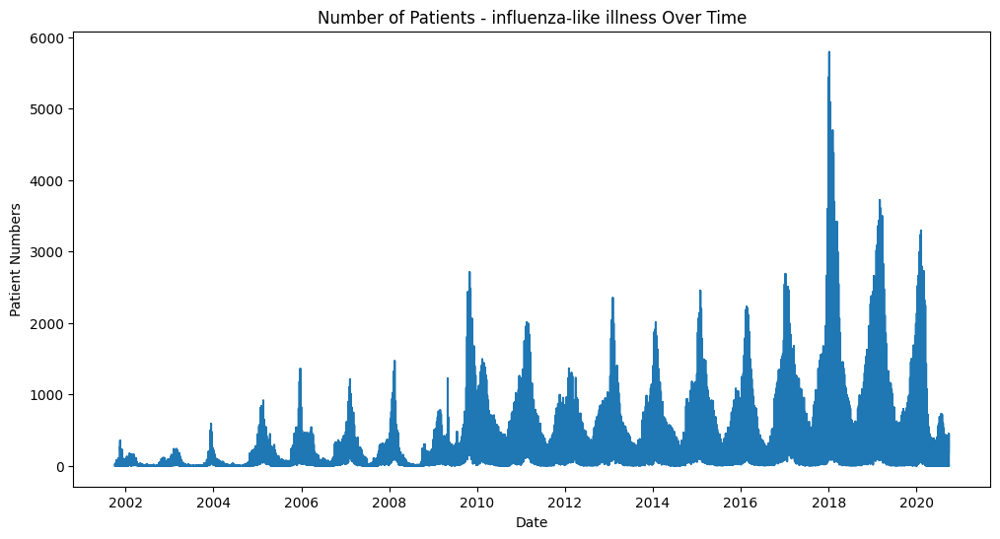

In [13]:
# visualize the data
# Before building the model, it's a good practice to visualize the time series to understand its patterns.

plt.figure(figsize=(12, 6))
plt.plot(data['Total_ILI'])
plt.xlabel('Date')
plt.ylabel('Patient Numbers')
plt.title('Number of Patients - influenza-like illness Over Time')
plt.show()

In [14]:
data.head(n=2)

,region,Total_ILI,Total_Patients_Seen,Percent_ILI,Number_Providers_Reporting
date,,,,,
2001-10-06,Bay Area,3,135,2.22,2
2001-10-06,California,25,1211,2.06,14


In [15]:
data.shape

(5946, 5)

**## Visualize All Regions on Total of ILI Patients**

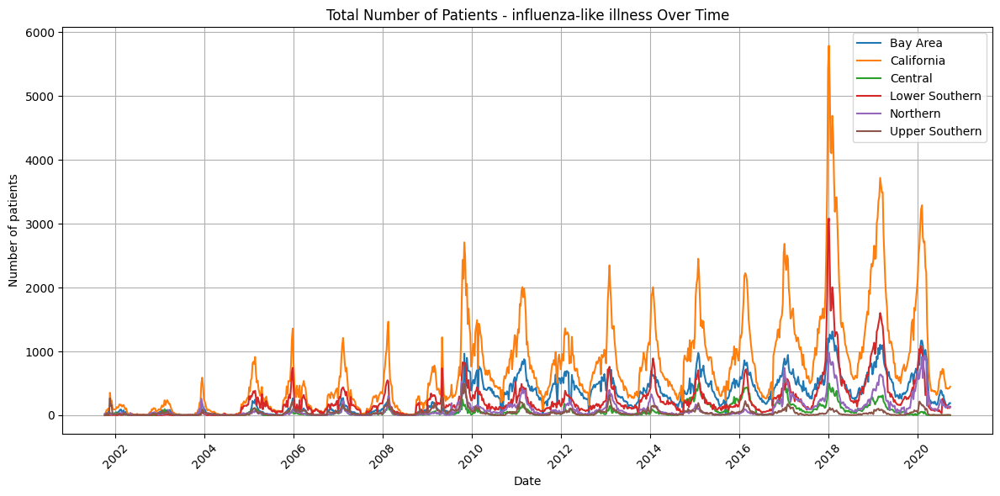

In [16]:
# Convert the index to datetime if it's not already in datetime format
data.index = pd.to_datetime(data.index)

# Extract unique regions
regions = data['region'].unique()

# Create a plot for each region
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed

for region in regions:
  region_data = data[data['region'] == region]
  plt.plot(region_data.index, region_data['Total_ILI'], label=region)

plt.xlabel('Date')
plt.ylabel('Number of patients')
plt.title('Total Number of Patients - influenza-like illness Over Time')
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

# **Visualize All Regions on Total of ILI Patients - Seen**

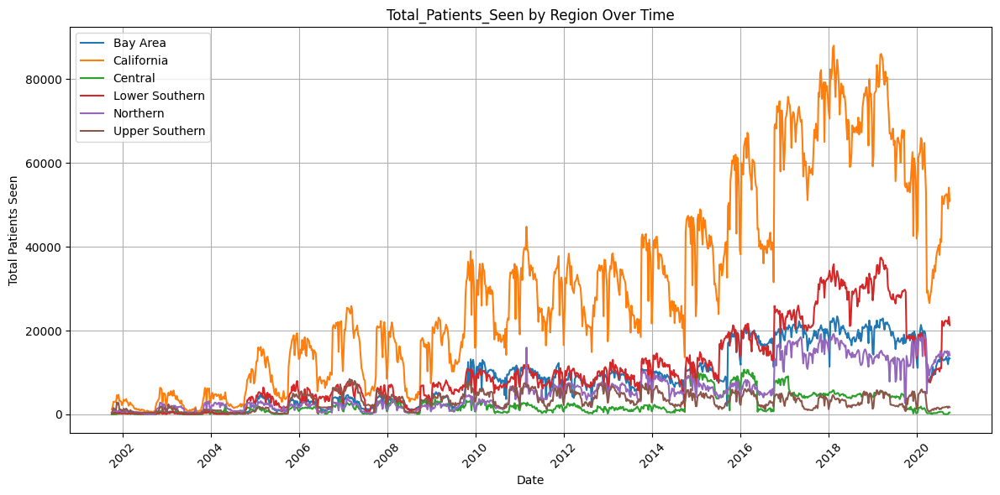

In [17]:
# Convert the index to datetime if it's not already in datetime format
data.index = pd.to_datetime(data.index)

# Extract unique regions
regions = data['region'].unique()

# Create a plot for each region
plt.figure(figsize=(12, 6))  # Adjust the figure size as needed

for region in regions:
  region_data = data[data['region'] == region]
  plt.plot(region_data.index, region_data['Total_Patients_Seen'], label=region)

plt.xlabel('Date')
plt.ylabel('Total Patients Seen')
plt.title('Total_Patients_Seen by Region Over Time')
plt.xticks(rotation=45)  # Rotate x-axis labels for better visibility
plt.legend()
plt.grid(True)

plt.tight_layout()
plt.show()

In [18]:
# Transform the original DataFrame to the desired format
df_transformed = data.groupby(['date', 'region'])['Total_ILI'].sum().unstack(fill_value=0)

# Reset the index and fill NaN values with 0 if needed
df_transformed.reset_index(inplace=True)
df_transformed.fillna(0, inplace=True)

# If you want to rename the columns as shown in your desired format
df_transformed.columns.name = None

# Display the transformed DataFrame
print(df_transformed)

          date  Bay Area  California  Central  Lower Southern  Northern  \
0   2001-10-06         3          25        0               2        20   
1   2001-10-13         3          38        0               3        26   
2   2001-10-20        21          80        0               3        23   
3   2001-10-27        24          79        0               8        32   
4   2001-11-03        52         105        0               5        33   
..         ...       ...         ...      ...             ...       ...   
986 2020-08-29       160         430        0             131       136   
987 2020-09-05       152         414        0             110       146   
988 2020-09-12       161         417        0             129       121   
989 2020-09-19       189         426        0             111       121   
990 2020-09-26       190         448        0             134       122   

     Upper Southern  
0                 0  
1                 6  
2                33  
3          

In [19]:
df_transformed.head(n=2)

,date,Bay Area,California,Central,Lower Southern,Northern,Upper Southern
0,2001-10-06,3,25,0,2,20,0
1,2001-10-13,3,38,0,3,26,6


In [20]:
# create sub df for each region
df_california = df_transformed[['date','California']]
df_bay_area = df_transformed[['date','Bay Area']]
df_central = df_transformed[['date','Central']]
df_lower_southern = df_transformed[['date','Lower Southern']]
df_northern = df_transformed[['date','Northern']]
df_upper_southern = df_transformed[['date','Upper Southern']]

In [21]:
df_california.head(n=2)

,date,California
0,2001-10-06,25
1,2001-10-13,38


In [22]:
df_bay_area.head(n=2)

,date,Bay Area
0,2001-10-06,3
1,2001-10-13,3


In [23]:
df_central.head(n=2)

,date,Central
0,2001-10-06,0
1,2001-10-13,0


In [24]:
df_lower_southern.head(n=2)

,date,Lower Southern
0,2001-10-06,2
1,2001-10-13,3


In [25]:
df_northern.head(n=2)

,date,Northern
0,2001-10-06,20
1,2001-10-13,26


In [26]:
df_upper_southern.head(n=2)

,date,Upper Southern
0,2001-10-06,0
1,2001-10-13,6


In [27]:
# rename columns to ds and y and make it ready for forecast with AR-Net
new_column_names_cal = {'date': 'ds', 'California': 'y'}
new_column_names_bay = {'date': 'ds', 'Bay Area': 'y'}
new_column_names_cen = {'date': 'ds', 'Central': 'y'}
new_column_names_low = {'date': 'ds', 'Lower Southern': 'y'}
new_column_names_nor = {'date': 'ds', 'Northern': 'y'}
new_column_names_upp = {'date': 'ds', 'Upper Southern': 'y'}

In [28]:
df_california.rename(columns=new_column_names_cal, inplace=True)
df_bay_area.rename(columns=new_column_names_bay, inplace=True)
df_central.rename(columns=new_column_names_cen, inplace=True)
df_lower_southern.rename(columns=new_column_names_low, inplace=True)
df_northern.rename(columns=new_column_names_nor, inplace=True)
df_upper_southern.rename(columns=new_column_names_upp, inplace=True)

# Visualize the datasets

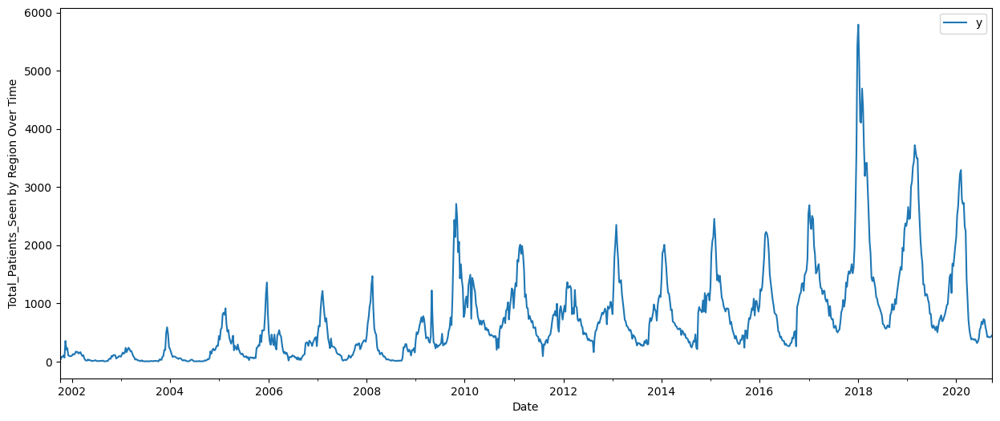

In [29]:
ax = df_california.set_index('ds').plot(figsize=(15, 6))
ax.set_ylabel('Total_Patients_Seen by Region Over Time')
ax.set_xlabel('Date')

plt.show()

# Training a NeuralProphet Model
We'll make a simple model with neural_prophet for this dataset, which can be fitted by creating an object of the NeuralProphet class. Here, the frequency of the dataset is 'week'. So we will use the change the frequency parameter accordingly. All the parameter are set by default by NeuralProphet. Model validation for NeuralProphet can be done in two ways. Users can split the dataset manually to validate after the model fitting like below by specifying the fraction of data to be used for validation in the argument valid_p. In this notebook, we will use the first method.

In [30]:
#pip install --upgrade neuralprophet

# Prediction for Bay Area of California

In [31]:
m = NeuralProphet()
df_train_bay_area, df_val_bay_area = m.split_df(df_bay_area, freq='W', valid_p = 0.2)
metrics_bay_area = m.fit(df_train_bay_area, freq='W', validation_df=df_val_bay_area)

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [32]:
metrics_bay_area

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,572.308777,720.469971,0.469166,0.0,0,499.353821,607.961914,0.282241,0.0
1,554.234985,698.509705,0.445514,0.0,1,482.042603,589.767334,0.266366,0.0
2,532.613098,672.828613,0.417875,0.0,2,461.114655,565.711182,0.248682,0.0
3,506.418793,641.569824,0.384926,0.0,3,436.546783,538.070557,0.226518,0.0
4,473.912048,602.440125,0.344908,0.0,4,405.612579,501.042603,0.200853,0.0
...,...,...,...,...,...,...,...,...,...
204,158.225494,218.127594,0.052307,0.0,204,76.905540,98.669510,0.008877,0.0
205,158.171860,218.055313,0.052272,0.0,205,77.172485,98.182198,0.008909,0.0
206,158.184280,218.075317,0.052281,0.0,206,77.043388,98.216980,0.008877,0.0
207,158.193985,218.093140,0.052290,0.0,207,76.915108,97.668045,0.008870,0.0


In [33]:
future_bay_area = m.make_future_dataframe(df_bay_area, periods=96, n_historic_predictions=len(df_bay_area))
forecast_bay_area = m.predict(future_bay_area)
forecast_bay_area

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,3,-76.406403,-20.846338,-55.560066
1,2001-10-13,3,-50.770729,-19.969870,-30.800858
2,2001-10-20,21,-26.059366,-19.093403,-6.965965
3,2001-10-27,24,-2.936961,-18.216934,15.279973
4,2001-11-03,52,17.749117,-17.340466,35.089584
...,...,...,...,...,...
1082,2022-06-26,None,432.067902,539.574097,-107.506180
1083,2022-07-03,None,419.304932,539.903809,-120.598862
1084,2022-07-10,None,408.252563,540.233521,-131.980942
1085,2022-07-17,None,398.881836,540.563171,-141.681335


In [35]:
# Visualize the forecast for Bay Area
m.plot(forecast_bay_area)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [36]:
# Visualize the components - Trend and Seasonality for Bay area
m.plot_components(forecast_bay_area)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [37]:
# Visualize the model parameters for Bay area
m.plot_parameters(forecast_bay_area)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


Text(0.5, 1.0, 'Model Loss (MAE)')

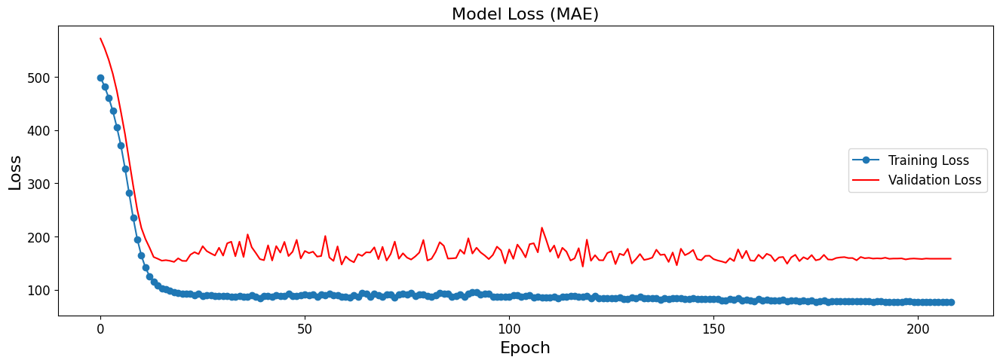

In [38]:
# Visualize Training and Validation Loss
fig, ax = plt.subplots(figsize=(16, 5))
ax.plot(metrics_bay_area["MAE"], '-o', label="Training Loss")
ax.plot(metrics_bay_area["MAE_val"], '-r', label="Validation Loss")
ax.legend(loc='center right', fontsize=12)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_xlabel("Epoch", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_title("Model Loss (MAE)", fontsize=16)

# Prediction for Central of California

In [39]:
m = NeuralProphet()
df_train_central, df_val_central = m.split_df(df_central, freq='W', valid_p = 0.2)
metrics_central = m.fit(df_train_central, freq='W', validation_df=df_val_central)

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [40]:
metrics_central

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,275.447052,311.276733,0.730119,0.0,0,233.064377,290.162140,0.403517,0.0
1,274.993164,307.679077,0.724678,0.0,1,219.573441,270.175873,0.367278,0.0
2,270.745544,300.649597,0.703168,0.0,2,204.790665,251.652618,0.328808,0.0
3,259.030609,285.987000,0.650571,0.0,3,189.582855,230.648514,0.288977,0.0
4,233.105225,258.139526,0.542374,0.0,4,172.697845,209.750824,0.245611,0.0
...,...,...,...,...,...,...,...,...,...
204,186.759430,211.638885,0.390079,0.0,204,35.761631,49.882809,0.022515,0.0
205,186.331741,211.246185,0.388777,0.0,205,35.778320,49.607311,0.022497,0.0
206,186.208130,211.131912,0.388421,0.0,206,35.924053,49.480343,0.022676,0.0
207,186.178009,211.105499,0.388329,0.0,207,35.754566,49.790718,0.022380,0.0


In [41]:
future_central = m.make_future_dataframe(df_central, periods=96, n_historic_predictions=len(df_central))
forecast_central = m.predict(future_central)
forecast_central

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,0,-13.349092,-3.451318,-9.897775
1,2001-10-13,0,-2.582799,-3.224133,0.641334
2,2001-10-20,0,6.544470,-2.996948,9.541418
3,2001-10-27,0,13.584379,-2.769763,16.354143
4,2001-11-03,0,18.551771,-2.542578,21.094349
...,...,...,...,...,...
1082,2022-06-26,None,387.878571,435.745667,-47.867104
1083,2022-07-03,None,386.270081,436.562225,-50.292152
1084,2022-07-10,None,385.566895,437.378906,-51.812035
1085,2022-07-17,None,386.056305,438.195557,-52.139244


In [43]:
# Visualize the forecast for Central of California
forecast_central_plot = m.plot(forecast_central)
forecast_central_plot

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [44]:
# Visualize the components for Central of California
m.plot_components(forecast_central)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [45]:
# Visualize the model parameters
m.plot_parameters(forecast_central)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


Text(0.5, 1.0, 'Model Loss (MAE)')

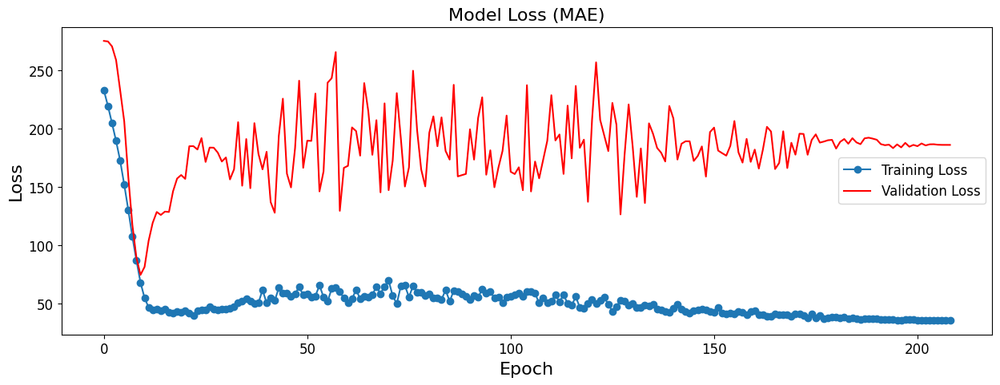

In [46]:
# Visualize Training and Validation Loss
fig, ax = plt.subplots(figsize=(15, 5))
ax.plot(metrics_central["MAE"], '-o', label="Training Loss")
ax.plot(metrics_central["MAE_val"], '-r', label="Validation Loss")
ax.legend(loc='center right', fontsize=12)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_xlabel("Epoch", fontsize=16)
ax.set_ylabel("Loss", fontsize=16)
ax.set_title("Model Loss (MAE)", fontsize=16)

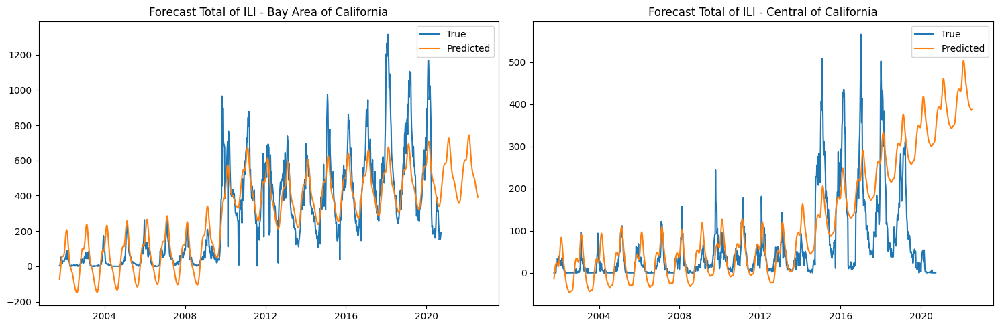

In [47]:
# Extracting information from forecast objects
ds_bay_area = forecast_bay_area['ds']
y_true_bay_area = forecast_bay_area['y']
y_pred_bay_area = forecast_bay_area['yhat1']

ds_central = forecast_central['ds']
y_true_central = forecast_central['y']
y_pred_central = forecast_central['yhat1']

# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(15, 5))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0].plot(ds_bay_area, y_true_bay_area, label='True')
axs[0].plot(ds_bay_area, y_pred_bay_area, label='Predicted')
axs[0].set_title('Forecast Total of ILI - Bay Area of California')
axs[0].legend()

# Plot the second forecast on the second subplot
axs[1].plot(ds_central, y_true_central, label='True')
axs[1].plot(ds_central, y_pred_central, label='Predicted')
axs[1].set_title('Forecast Total of ILI - Central of California')
axs[1].legend()

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()

# Visualize the two plots in the same Y-axis value

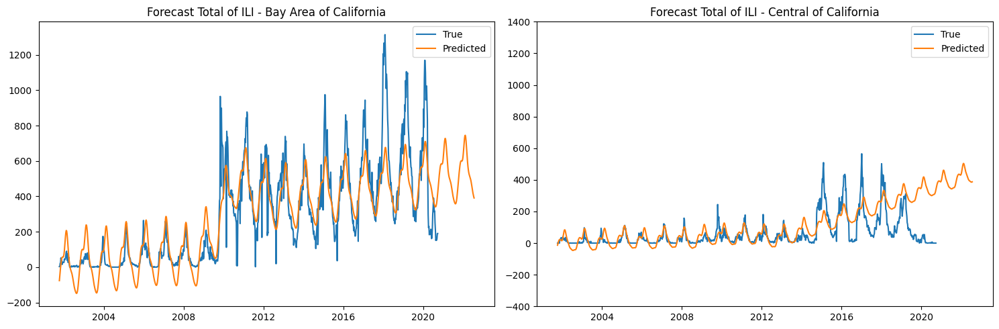

In [48]:
# Extracting information from forecast objects
ds_bay_area = forecast_bay_area['ds']
y_true_bay_area = forecast_bay_area['y']
y_pred_bay_area = forecast_bay_area['yhat1']

ds_central = forecast_central['ds']
y_true_central = forecast_central['y']
y_pred_central = forecast_central['yhat1']

# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(15, 5))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0].plot(ds_bay_area, y_true_bay_area, label='True')
axs[0].plot(ds_bay_area, y_pred_bay_area, label='Predicted')
axs[0].set_title('Forecast Total of ILI - Bay Area of California')
axs[0].legend()

# Plot the second forecast on the second subplot
axs[1].plot(ds_central, y_true_central, label='True')
axs[1].plot(ds_central, y_pred_central, label='Predicted')
axs[1].set_title('Forecast Total of ILI - Central of California')
axs[1].legend()

# Set y-ticks of the second subplot to match the first subplot
axs[1].set_yticks(axs[0].get_yticks())

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()


# Prediction Total of ILI for Lower of Southern California

In [49]:
m = NeuralProphet()
df_train_lower_southern, df_val_lower_southern = m.split_df(df_lower_southern, freq='W', valid_p = 0.2)
metrics_lower_southern = m.fit(df_train_lower_southern, freq='W', validation_df=df_val_lower_southern)

metrics_lower_southern

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,985.687805,1156.924683,1.726153,0.0,0,834.079346,890.590637,1.023413,0.0
1,942.267273,1119.069946,1.636530,0.0,1,810.397095,867.026733,0.981726,0.0
2,890.270447,1073.400269,1.530407,0.0,2,779.765442,837.795776,0.930273,0.0
3,824.736511,1016.302063,1.399401,0.0,3,740.646423,800.939758,0.864552,0.0
4,745.461304,946.772583,1.243663,0.0,4,693.854004,756.561646,0.787620,0.0
...,...,...,...,...,...,...,...,...,...
204,338.189484,555.126587,0.457775,0.0,204,64.333572,94.731689,0.019081,0.0
205,338.120056,555.101746,0.457718,0.0,205,64.532410,95.484467,0.019111,0.0
206,338.196259,555.156860,0.457809,0.0,206,64.240303,95.040886,0.019064,0.0
207,338.127930,555.114868,0.457727,0.0,207,64.355301,93.447899,0.019159,0.0


In [50]:
future_lower_southern = m.make_future_dataframe(df_lower_southern, periods=96, n_historic_predictions=len(df_lower_southern))
forecast_lower_southern = m.predict(future_lower_southern)
forecast_lower_southern

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,2,-68.644814,-33.843952,-34.800861
1,2001-10-13,3,-45.608078,-33.095921,-12.512155
2,2001-10-20,3,-27.326744,-32.347885,5.021141
3,2001-10-27,8,-15.400268,-31.599850,16.199583
4,2001-11-03,5,-9.645514,-30.851818,21.206306
...,...,...,...,...,...
1082,2022-06-26,None,90.994873,181.506256,-90.511375
1083,2022-07-03,None,83.534935,181.389236,-97.854294
1084,2022-07-10,None,77.330078,181.272186,-103.942108
1085,2022-07-17,None,73.698471,181.155151,-107.456680


In [51]:
# Visualize the forecast  for Lower of California
m.plot(forecast_lower_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [52]:
# Visualize the components
m.plot_components(forecast_lower_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [53]:
# Visualize the model parameters
m.plot_parameters(forecast_lower_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


# Prediction Total of ILI for Northern California

In [54]:
m = NeuralProphet()
df_train_northern, df_val_northern = m.split_df(df_northern, freq='W', valid_p = 0.2)
metrics_northern = m.fit(df_train_northern, freq='W', validation_df=df_val_northern)

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [55]:
metrics_northern

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,245.534805,302.655273,0.759877,0.0,0,302.184143,347.302429,0.743825,0.0
1,234.930298,292.021301,0.718866,0.0,1,291.034302,335.830078,0.705041,0.0
2,223.804077,281.650116,0.678724,0.0,2,279.559784,324.271423,0.665040,0.0
3,211.285751,269.559601,0.631631,0.0,3,264.062897,307.844177,0.610516,0.0
4,199.476013,258.028290,0.584693,0.0,4,245.587311,287.985657,0.548690,0.0
...,...,...,...,...,...,...,...,...,...
204,260.718231,326.085968,0.792575,0.0,204,35.319813,53.239361,0.028966,0.0
205,260.622345,326.005981,0.792204,0.0,205,35.339432,51.640736,0.028700,0.0
206,260.700317,326.074554,0.792499,0.0,206,35.154324,52.217438,0.028380,0.0
207,260.692963,326.071014,0.792476,0.0,207,35.080070,51.727806,0.028293,0.0


In [56]:
future_northern = m.make_future_dataframe(df_northern, periods=96, n_historic_predictions=len(df_northern))
forecast_northern = m.predict(future_northern)
forecast_northern

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,20,-2.875965,3.719612,-6.595577
1,2001-10-13,26,8.677603,3.948671,4.728931
2,2001-10-20,23,18.769215,4.177731,14.591482
3,2001-10-27,32,26.133730,4.406790,21.726940
4,2001-11-03,33,30.246916,4.635849,25.611067
...,...,...,...,...,...
1082,2022-06-26,None,-67.877823,-24.931030,-42.946789
1083,2022-07-03,None,-69.243034,-25.161512,-44.081520
1084,2022-07-10,None,-70.596413,-25.392019,-45.204399
1085,2022-07-17,None,-71.636566,-25.622526,-46.014042


In [57]:
# Visualize the forecast for Northern of California
m.plot(forecast_northern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [58]:
# Visualize the components
m.plot_components(forecast_northern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [59]:
# Visualize the model parameters
m.plot_parameters(forecast_northern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


# Compare between two areas - Lower Southern vs. Northern of California

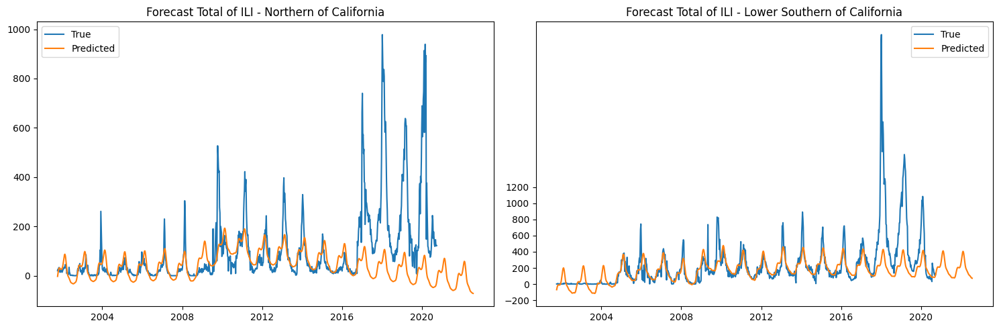

In [60]:
# Extracting information from forecast objects
ds_northern = forecast_northern['ds']
y_true_northern = forecast_northern['y']
y_pred_northern = forecast_northern['yhat1']

ds_lower_southern = forecast_lower_southern['ds']
y_true_lower_southern = forecast_lower_southern['y']
y_pred_lower_southern = forecast_lower_southern['yhat1']

# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(15, 5))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0].plot(ds_northern, y_true_northern, label='True')
axs[0].plot(ds_northern, y_pred_northern, label='Predicted')
axs[0].set_title('Forecast Total of ILI - Northern of California')
axs[0].legend()

# Plot the second forecast on the second subplot
axs[1].plot(ds_lower_southern, y_true_lower_southern, label='True')
axs[1].plot(ds_lower_southern, y_pred_lower_southern, label='Predicted')
axs[1].set_title('Forecast Total of ILI - Lower Southern of California')
axs[1].legend()

# Set y-ticks of the second subplot to match the first subplot
axs[1].set_yticks(axs[0].get_yticks())

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()

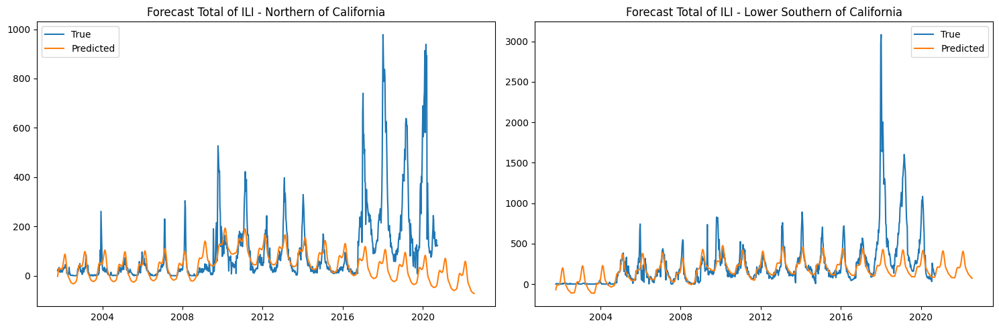

In [61]:
# Extracting information from forecast objects
ds_northern = forecast_northern['ds']
y_true_northern = forecast_northern['y']
y_pred_northern = forecast_northern['yhat1']

ds_lower_southern = forecast_lower_southern['ds']
y_true_lower_southern = forecast_lower_southern['y']
y_pred_lower_southern = forecast_lower_southern['yhat1']

# Create a figure with two subplots side by side
fig, axs = plt.subplots(1, 2, figsize=(15, 5))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0].plot(ds_northern, y_true_northern, label='True')
axs[0].plot(ds_northern, y_pred_northern, label='Predicted')
axs[0].set_title('Forecast Total of ILI - Northern of California')
axs[0].legend()

# Plot the second forecast on the second subplot
axs[1].plot(ds_lower_southern, y_true_lower_southern, label='True')
axs[1].plot(ds_lower_southern, y_pred_lower_southern, label='Predicted')
axs[1].set_title('Forecast Total of ILI - Lower Southern of California')
axs[1].legend()

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()

# Prediction Total of ILI for Upper of Southern California

In [62]:
m = NeuralProphet()
df_train_upper_southern, df_val_upper_southern = m.split_df(df_upper_southern, freq='W', valid_p = 0.2)
metrics_upper_southern = m.fit(df_train_upper_southern, freq='W', validation_df=df_val_upper_southern)

metrics_upper_southern

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,79.470001,101.293381,0.221881,0.0,0,85.509521,106.898369,0.172269,0.0
1,80.076988,101.253929,0.222910,0.0,1,82.997658,103.877716,0.163499,0.0
2,81.212128,101.512794,0.225361,0.0,2,80.330399,101.244461,0.154879,0.0
3,82.327370,101.362137,0.226302,0.0,3,77.089897,96.488129,0.144415,0.0
4,83.938354,101.210503,0.227562,0.0,4,73.377350,92.525589,0.132922,0.0
...,...,...,...,...,...,...,...,...,...
204,15.769544,23.638456,0.012859,0.0,204,22.417618,35.349220,0.025513,0.0
205,15.761702,23.631409,0.012852,0.0,205,22.576242,36.084408,0.025893,0.0
206,15.763240,23.637016,0.012858,0.0,206,22.638042,35.499424,0.025856,0.0
207,15.764484,23.633699,0.012854,0.0,207,22.559467,35.622890,0.025701,0.0


In [63]:
future_upper_southern = m.make_future_dataframe(df_upper_southern, periods=96, n_historic_predictions=len(df_upper_southern))
forecast_upper_southern = m.predict(future_upper_southern)
forecast_upper_southern

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,0,3.940634,13.779543,-9.838910
1,2001-10-13,6,11.638747,13.798249,-2.159501
2,2001-10-20,33,18.514679,13.816956,4.697724
3,2001-10-27,15,24.222567,13.835662,10.386906
4,2001-11-03,15,28.534899,13.854368,14.680531
...,...,...,...,...,...
1082,2022-06-26,None,-6.242152,30.883904,-37.126053
1083,2022-07-03,None,-6.668114,30.840958,-37.509071
1084,2022-07-10,None,-6.094385,30.798010,-36.892395
1085,2022-07-17,None,-4.798104,30.755060,-35.553165


In [64]:
# Visualize the forecast by model
m.plot(forecast_upper_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [65]:
# Visualize the components
m.plot_components(forecast_upper_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [66]:
# Visualize the model parameters
m.plot_parameters(forecast_upper_southern)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


# Prediction for California (All Regions Combined)

In [67]:
m = NeuralProphet()
df_train_california, df_val_california = m.split_df(df_california, freq='W', valid_p = 0.2)
metrics_california = m.fit(df_train_california, freq='W', validation_df=df_val_california)

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
WARNING - (NP.forecaster.fit) - When Global modeling with local normalization, metrics are displayed in normalized scale.
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.874% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.874% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Define

Finding best initial lr:   0%|          | 0/223 [00:00<?, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

In [68]:
metrics_california

,MAE_val,RMSE_val,Loss_val,RegLoss_val,epoch,MAE,RMSE,Loss,RegLoss
0,7490.765625,7610.849121,4.478577,0.0,0,6333.961426,6447.531250,2.839924,0.0
1,7159.234863,7285.321777,4.258232,0.0,1,6137.145508,6251.943359,2.733077,0.0
2,6753.695801,6888.421875,3.988699,0.0,2,5912.350098,6025.931152,2.616443,0.0
3,6244.587891,6391.572754,3.650331,0.0,3,5627.699219,5743.057617,2.459703,0.0
4,5591.573242,5756.616699,3.216318,0.0,4,5262.810059,5381.012695,2.270323,0.0
...,...,...,...,...,...,...,...,...,...
204,635.080627,997.098328,0.183708,0.0,204,185.785782,254.862259,0.011945,0.0
205,635.698547,997.836609,0.183965,0.0,205,185.460709,254.377319,0.011921,0.0
206,635.183838,997.163086,0.183741,0.0,206,185.330521,250.347595,0.011908,0.0
207,635.129028,997.088684,0.183714,0.0,207,185.517944,256.255737,0.011925,0.0


In [69]:
future_california = m.make_future_dataframe(df_california, periods=96, n_historic_predictions=len(df_california))
forecast_california = m.predict(future_california)
forecast_california

INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.899% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.899% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency) - Defined frequency is equal to major frequency - W
INFO:NP.df_utils:Defined frequency is equal to major frequency - W
INFO - (NP.df_utils._infer_frequency) - Major frequency W-SAT corresponds to 99.816% of the data.
INFO:NP.df_utils:Major frequency W-SAT corresponds to 99.816% of the data.
INFO - (NP.df_utils._infer_frequency

Predicting: 50it [00:00, ?it/s]

INFO - (NP.df_utils.return_df_in_original_format) - Returning df with no ID column
INFO:NP.df_utils:Returning df with no ID column


,ds,y,yhat1,trend,season_yearly
0,2001-10-06,25,-159.078522,-51.521557,-107.556976
1,2001-10-13,38,-74.820244,-49.046783,-25.773464
2,2001-10-20,80,-2.365752,-46.572010,44.206261
3,2001-10-27,79,52.955036,-44.097240,97.052277
4,2001-11-03,105,89.767075,-41.622467,131.389542
...,...,...,...,...,...
1082,2022-06-26,None,821.242920,1148.074097,-326.831207
1083,2022-07-03,None,796.443359,1148.795044,-352.351654
1084,2022-07-10,None,776.588867,1149.515991,-372.927155
1085,2022-07-17,None,763.892456,1150.237061,-386.344574


In [70]:
# Visualize the forecast for all regions of California
m.plot(forecast_california)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [71]:
# Visualize the components
m.plot_components(forecast_california)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


In [72]:
# Visualize the model parameters
m.plot_parameters(forecast_california)

WARNING - (NP.plotting.log_warning_resampler_switch_to_valid_env) - Warning: plotly-resampler not supported for the environment you are using. Plotting backend automatically switched to 'plotly' without resampling 


Text(0.5, 1.0, 'Model Loss (MAE)')

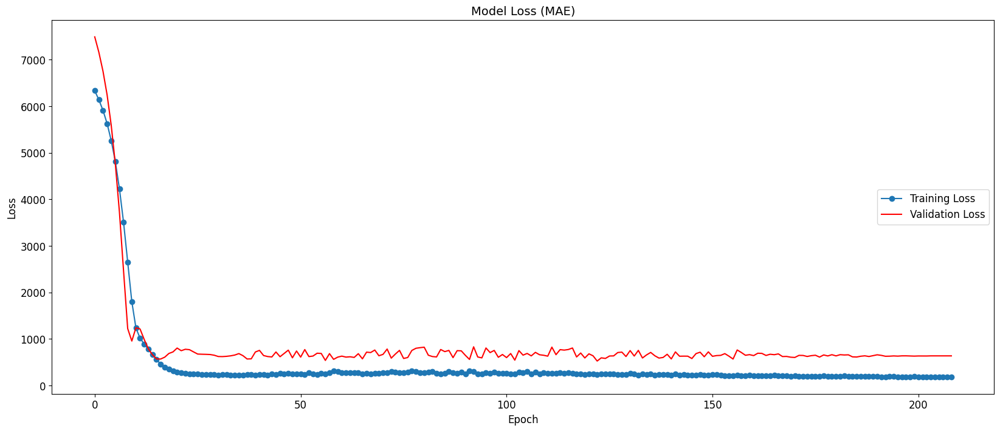

In [73]:
# Visualize Training and Validation Loss
fig, ax = plt.subplots(figsize=(20, 8))
ax.plot(metrics_california["MAE"], '-o', label="Training Loss")
ax.plot(metrics_california["MAE_val"], '-r', label="Validation Loss")
ax.legend(loc='center right', fontsize=12)
ax.tick_params(axis='both', which='major', labelsize=12)
ax.set_xlabel("Epoch", fontsize=12)
ax.set_ylabel("Loss", fontsize=12)
ax.set_title("Model Loss (MAE)", fontsize=14)

# Compare all Regions in California

In [ ]:
#m.plot(forecast_bay_area)
#m.plot(forecast_northern)
#m.plot(forecast_central)
#m.plot(forecast_upper_southern)
#m.plot(forecast_lower_southern)

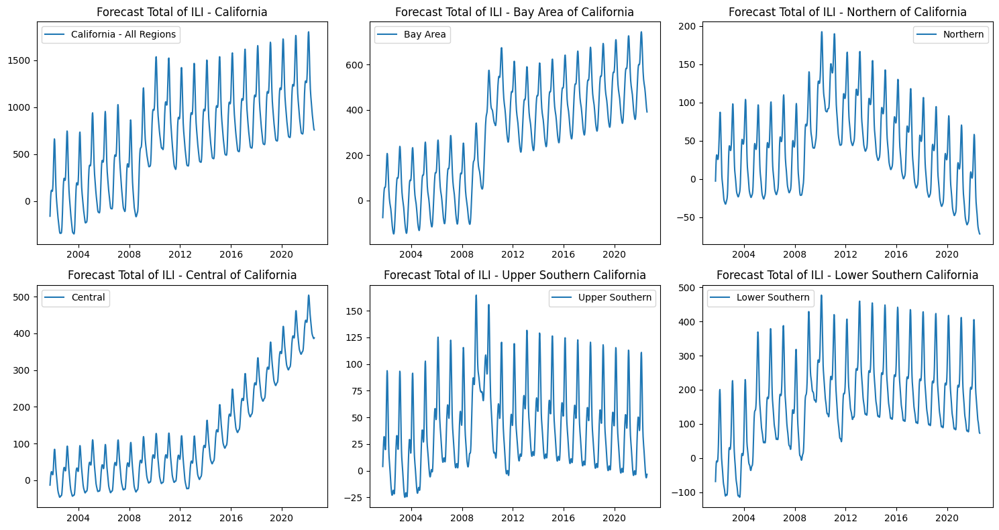

In [74]:
import matplotlib.pyplot as plt

# Assuming forecast_bay_area, forecast_northern, forecast_central, forecast_upper_southern,
# and forecast_lower_southern are NeuralProphet forecast objects
#forecast_bay_area = m.predict(df_bay_area)  # Replace df_bay_area with your data
#forecast_northern = m.predict(df_northern)  # Replace df_northern with your data
#forecast_central = m.predict(df_central)    # Replace df_central with your data
#forecast_upper_southern = m.predict(df_upper_southern)  # Replace df_upper_southern with your data
#forecast_lower_southern = m.predict(df_lower_southern)  # Replace df_lower_southern with your data

# Extracting information from forecast objects
ds_bay_area = forecast_bay_area['ds']
y_pred_bay_area = forecast_bay_area['yhat1']

ds_northern = forecast_northern['ds']
y_pred_northern = forecast_northern['yhat1']

ds_central = forecast_central['ds']
y_pred_central = forecast_central['yhat1']

ds_upper_southern = forecast_upper_southern['ds']
y_pred_upper_southern = forecast_upper_southern['yhat1']

ds_lower_southern = forecast_lower_southern['ds']
y_pred_lower_southern = forecast_lower_southern['yhat1']

ds_california = forecast_california['ds']
y_pred_california = forecast_california['yhat1']

# Create a figure with a 2x3 grid of subplots
fig, axs = plt.subplots(2, 3, figsize=(15, 8))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0, 0].plot(ds_california, y_pred_california, label='California - All Regions')
axs[0, 0].set_title('Forecast Total of ILI - California')
axs[0, 0].legend()

# Plot the second forecast on the second subplot
axs[0, 1].plot(ds_bay_area, y_pred_bay_area, label='Bay Area')
axs[0, 1].set_title('Forecast Total of ILI - Bay Area of California')
axs[0, 1].legend()

# Plot the third forecast on the third subplot
axs[0, 2].plot(ds_northern, y_pred_northern, label='Northern')
axs[0, 2].set_title('Forecast Total of ILI - Northern of California')
axs[0, 2].legend()

# Plot the fourth forecast on the fourth subplot
axs[1, 0].plot(ds_central, y_pred_central, label='Central')
axs[1, 0].set_title('Forecast Total of ILI - Central of California')
axs[1, 0].legend()

# Plot the fifth forecast on the fifth subplot
axs[1, 1].plot(ds_upper_southern, y_pred_upper_southern, label='Upper Southern')
axs[1, 1].set_title('Forecast Total of ILI - Upper Southern California')
axs[1, 1].legend()

# Plot the sixth forecast on the sixth subplot
axs[1, 2].plot(ds_lower_southern, y_pred_lower_southern, label='Lower Southern')
axs[1, 2].set_title('Forecast Total of ILI - Lower Southern California')
axs[1, 2].legend()


# Remove empty subplot
#fig.delaxes(axs[1, 2])

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()


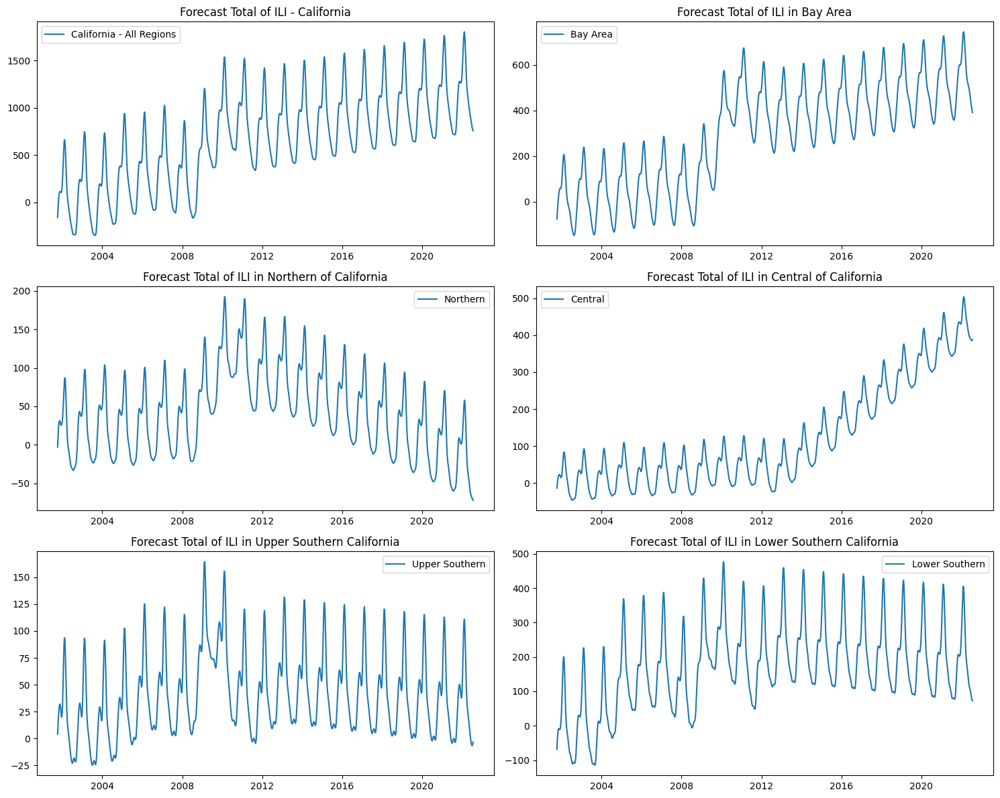

In [75]:
import matplotlib.pyplot as plt

# Assuming forecast_bay_area, forecast_northern, forecast_central, forecast_upper_southern,
# and forecast_lower_southern are NeuralProphet forecast objects
#forecast_bay_area = m.predict(df_bay_area)  # Replace df_bay_area with your data
#forecast_northern = m.predict(df_northern)  # Replace df_northern with your data
#forecast_central = m.predict(df_central)    # Replace df_central with your data
#forecast_upper_southern = m.predict(df_upper_southern)  # Replace df_upper_southern with your data
#forecast_lower_southern = m.predict(df_lower_southern)  # Replace df_lower_southern with your data

# Extracting information from forecast objects
ds_bay_area = forecast_bay_area['ds']
y_pred_bay_area = forecast_bay_area['yhat1']

ds_northern = forecast_northern['ds']
y_pred_northern = forecast_northern['yhat1']

ds_central = forecast_central['ds']
y_pred_central = forecast_central['yhat1']

ds_upper_southern = forecast_upper_southern['ds']
y_pred_upper_southern = forecast_upper_southern['yhat1']

ds_lower_southern = forecast_lower_southern['ds']
y_pred_lower_southern = forecast_lower_southern['yhat1']

ds_california = forecast_california['ds']
y_pred_california = forecast_california['yhat1']

# Create a figure with a 3x2 grid of subplots
fig, axs = plt.subplots(3, 2, figsize=(15, 12))  # Adjust the figsize as needed

# Plot the first forecast on the first subplot
axs[0, 0].plot(ds_california, y_pred_california, label='California - All Regions')
axs[0, 0].set_title('Forecast Total of ILI - California')
axs[0, 0].legend()

# Plot the second forecast on the second subplot
axs[0, 1].plot(ds_bay_area, y_pred_bay_area, label='Bay Area')
axs[0, 1].set_title('Forecast Total of ILI in Bay Area')
axs[0, 1].legend()

# Plot the third forecast on the third subplot
axs[1, 0].plot(ds_northern, y_pred_northern, label='Northern')
axs[1, 0].set_title('Forecast Total of ILI in Northern of California')
axs[1, 0].legend()

# Plot the fourth forecast on the fourth subplot
axs[1, 1].plot(ds_central, y_pred_central, label='Central')
axs[1, 1].set_title('Forecast Total of ILI in Central of California')
axs[1, 1].legend()

# Plot the fifth forecast on the fifth subplot
axs[2, 0].plot(ds_upper_southern, y_pred_upper_southern, label='Upper Southern')
axs[2, 0].set_title('Forecast Total of ILI in Upper Southern California')
axs[2, 0].legend()

# Plot the sixth forecast on the sixth subplot
axs[2, 1].plot(ds_lower_southern, y_pred_lower_southern, label='Lower Southern')
axs[2, 1].set_title('Forecast Total of ILI in Lower Southern California')
axs[2, 1].legend()

# Remove empty subplot
#fig.delaxes(axs[2, 1])

# Adjust layout for better spacing
plt.tight_layout()

# Show the plots
plt.show()


# As the results from all forecasts above, we can conclude:

- In California, encompassing all its regions, the incidence of influenza-like illness (ILI) patients exhibited an upward trend from 2001 to 2007. However, there was a decline in 2008, followed by a subsequent rise in ILI cases in 2009, 2010, and 2011. The forecast indicates a consistent increase in ILI patients from 2012 to 2022.
- In the Bay Area, the forecast suggests a steady increase in influenza-like illness (ILI) patients from 2001 to 2009. Nevertheless, there was a notable spike in cases in 2009, followed by continued elevated numbers in 2010 and reaching a peak in 2011. The projection anticipates a sustained rise in ILI patients from 2012 to 2022.
- In Northern California, the forecast reveals a consistent growth in influenza-like illness (ILI) patients from 2001 to 2008, with a subsequent upsurge in ILI cases observed in 2009, 2010, and 2011. Contrarily, the forecast indicates a steady decrease in ILI patients from 2012 to 2022.
- In Central California, the forecast shows a gradual and steady increase in influenza-like illness (ILI) patients from 2001 to 2012. However, a notable shift is observed in the forecast, indicating a substantial and sudden rise in ILI patients from 2013 to 2022.
- In Upper Southern California, the forecast depicts a gradual and consistent rise in influenza-like illness (ILI) patients from 2001 to 2009. Conversely, there is a continuous decline in ILI patients indicated by the forecast from 2010 to 2022.
- In Lower Southern California, the forecast indicates a steady increase in influenza-like illness (ILI) patients from 2001 to 2010. However, there is a decline in 2011 and 2012, followed by a resurgence in 2013. From 2013 to 2022, the forecast projects a continuous decrease slowly in ILI patients.